# Data Visualization

In [1]:
# Dependencies
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

# ignore warning
from warnings import filterwarnings
filterwarnings('ignore')

## Data preparation

In [2]:
# Load the data 
input_data_source = './Data_Source/AustinTXAccidentsData.csv'
raw_data = pd.read_csv(input_data_source, encoding='utf-8')
# review
raw_data

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),...,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,A-261009,Source2,2,2016-11-30 16:03:54,2016-11-30 17:20:00,30.336502,-97.755646,NaN,NaN,0.010,...,False,False,False,False,False,False,Day,Day,Day,Day
1,A-261010,Source2,2,2016-11-30 16:32:18,2016-11-30 17:47:02,30.328165,-97.694305,NaN,NaN,0.000,...,False,False,False,False,False,False,Day,Day,Day,Day
2,A-261011,Source2,2,2016-11-30 16:31:45,2016-11-30 17:46:34,30.326077,-97.692307,NaN,NaN,0.000,...,False,True,False,False,True,False,Day,Day,Day,Day
3,A-261028,Source2,2,2016-11-30 17:11:22,2016-11-30 17:41:09,30.332523,-97.686707,NaN,NaN,0.010,...,False,False,False,False,False,False,Day,Day,Day,Day
4,A-261039,Source2,2,2016-11-30 17:16:42,2016-11-30 17:46:32,30.292852,-97.747017,NaN,NaN,0.010,...,False,False,False,False,False,False,Day,Day,Day,Day
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96599,A-7775008,Source1,4,2019-08-18 04:03:40,2019-08-18 04:33:09,30.341300,-97.769622,30.341689,-97.782289,0.756,...,False,False,False,False,True,False,Night,Night,Night,Night
96600,A-7775009,Source1,4,2019-08-18 04:03:40,2019-08-18 04:33:09,30.341688,-97.782288,30.341300,-97.769622,0.756,...,False,False,False,False,False,False,Night,Night,Night,Night
96601,A-7775010,Source1,4,2019-08-18 05:18:40,2019-08-18 05:47:20,30.341688,-97.782288,30.341300,-97.769622,0.756,...,False,False,False,False,False,False,Night,Night,Night,Night
96602,A-7777478,Source1,2,2019-08-23 08:34:56,2019-08-23 09:04:52,30.437960,-97.777150,30.432260,-97.765890,0.778,...,False,False,False,False,False,False,Day,Day,Day,Day


In [3]:
raw_data.columns

Index(['ID', 'Source', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat',
       'Start_Lng', 'End_Lat', 'End_Lng', 'Distance(mi)', 'Description',
       'Street', 'City', 'County', 'State', 'Zipcode', 'Country', 'Timezone',
       'Airport_Code', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
       'Turning_Loop', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight'],
      dtype='object')

There are four columns (`Sunrise_Sunset`, `Civil_Twilight`, `Nautical_Twilight`, and `Astronomical_Twilight`), among which Sunrise_Sunset focuses on the specific times of sunrise and sunset. This column is the most direct and commonly used, so it is recommended to keep only this column.

In [4]:
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96604 entries, 0 to 96603
Data columns (total 46 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   ID                     96604 non-null  object 
 1   Source                 96604 non-null  object 
 2   Severity               96604 non-null  int64  
 3   Start_Time             96604 non-null  object 
 4   End_Time               96604 non-null  object 
 5   Start_Lat              96604 non-null  float64
 6   Start_Lng              96604 non-null  float64
 7   End_Lat                28158 non-null  float64
 8   End_Lng                28158 non-null  float64
 9   Distance(mi)           96604 non-null  float64
 10  Description            96604 non-null  object 
 11  Street                 96559 non-null  object 
 12  City                   96604 non-null  object 
 13  County                 96604 non-null  object 
 14  State                  96604 non-null  object 
 15  Zi

In [5]:
raw_data.describe()

,Severity,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Speed(mph),Precipitation(in)
count,96604.000000,96604.000000,96604.000000,28158.000000,28158.000000,96604.000000,95446.000000,50955.000000,94848.000000,95699.000000,94876.000000,85524.000000,55192.000000
mean,2.088785,30.297193,-97.740694,30.294265,-97.738226,0.133442,71.288335,68.276395,62.655280,29.668862,9.245925,6.388303,0.008166
std,0.322085,0.084292,0.064397,0.085402,0.067412,0.508958,16.406792,18.896617,22.345977,0.393617,2.057099,4.233781,0.062324
min,1.000000,30.070537,-98.064842,29.638580,-98.214450,0.000000,1.000000,-17.000000,9.000000,28.320000,0.000000,0.000000,0.000000
25%,2.000000,30.233083,-97.771538,30.232232,-97.770927,0.000000,60.100000,56.000000,44.000000,29.320000,10.000000,3.500000,0.000000
50%,2.000000,30.286921,-97.735562,30.283755,-97.733925,0.000000,73.000000,72.000000,63.000000,29.650000,10.000000,6.000000,0.000000
75%,2.000000,30.363173,-97.697701,30.363435,-97.692470,0.048000,84.000000,82.000000,83.000000,29.990000,10.000000,8.100000,0.000000
max,4.000000,30.513420,-97.554594,30.520202,-97.532389,52.876000,136.400000,107.000000,100.000000,30.830000,46.000000,44.000000,2.550000


In [6]:
# Calculate the missing values
missing_values = (
    raw_data.isnull()
    .sum()
    .sort_values(ascending = False)
)

# Review
missing_values

End_Lat                  68446
End_Lng                  68446
Wind_Chill(F)            45649
Precipitation(in)        41412
Wind_Speed(mph)          11080
Wind_Direction            2610
Humidity(%)               1756
Visibility(mi)            1728
Weather_Condition         1610
Temperature(F)            1158
Pressure(in)               905
Weather_Timestamp          821
Street                      45
Airport_Code                 1
Traffic_Calming              0
Nautical_Twilight            0
Civil_Twilight               0
Sunrise_Sunset               0
Turning_Loop                 0
Crossing                     0
Traffic_Signal               0
Stop                         0
Station                      0
Give_Way                     0
Junction                     0
No_Exit                      0
Bump                         0
Roundabout                   0
Railway                      0
ID                           0
Amenity                      0
Source                       0
Timezone

<Axes: >

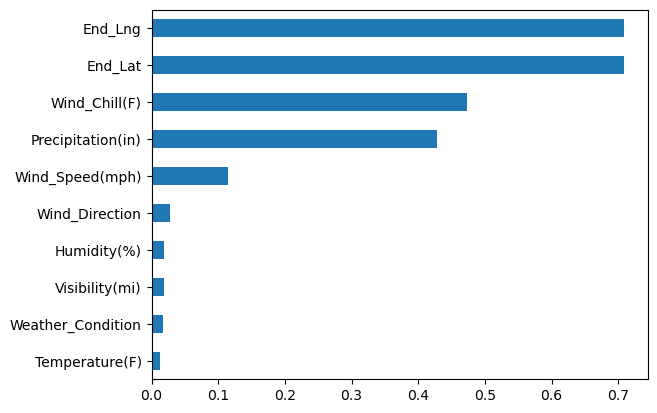

In [7]:
# Calculate the missing value percentage
missing_values_percent = missing_values / len(raw_data)

missing_values_percent_sorted = (
    missing_values_percent
    .head(10)
    .sort_values(ascending = True)
)
# build a bar chart
missing_values_percent_sorted.plot(kind = 'barh')   #horizontal bar chart

There are 4 columns(includes End_lng, End_lat, Wind_chill, and Precipitation) that have missing value more than 40% of total, we should not use them for analysis and visualization.

In [8]:
# keep These columns
cols_to_keep = ['ID', 
                'Severity', 
                'Start_Time', 
                'End_Time', 
                'Start_Lat',
                'Start_Lng', 
                'Distance(mi)',
                'Street', 
                'City', 
                'County', 
                'Zipcode', 
                'Weather_Timestamp', 
                'Temperature(F)', 
                'Humidity(%)', 
                'Pressure(in)', 
                'Visibility(mi)', 
                'Wind_Direction',
                'Wind_Speed(mph)', 
                'Precipitation(in)', 
                'Weather_Condition', 
                'Amenity',
                'Bump', 
                'Crossing', 
                'Give_Way', 
                'Junction', 
                'No_Exit', 
                'Railway',
                'Roundabout', 
                'Station', 
                'Stop', 
                'Traffic_Calming', 
                'Traffic_Signal',
                'Turning_Loop', 
                'Sunrise_Sunset', 
]

austin_accident_df = raw_data[cols_to_keep]

# convert column's name into lower case
austin_accident_df.columns = austin_accident_df.columns.str.lower()

# Review
austin_accident_df

,id,severity,start_time,end_time,start_lat,start_lng,distance(mi),street,city,county,...,junction,no_exit,railway,roundabout,station,stop,traffic_calming,traffic_signal,turning_loop,sunrise_sunset
0,A-261009,2,2016-11-30 16:03:54,2016-11-30 17:20:00,30.336502,-97.755646,0.010,Mopac Expy S,Austin,Travis,...,False,False,False,False,False,False,False,False,False,Day
1,A-261010,2,2016-11-30 16:32:18,2016-11-30 17:47:02,30.328165,-97.694305,0.000,E Saint Johns Ave,Austin,Travis,...,False,False,False,False,False,False,False,False,False,Day
2,A-261011,2,2016-11-30 16:31:45,2016-11-30 17:46:34,30.326077,-97.692307,0.000,Cameron Rd,Austin,Travis,...,False,False,False,False,True,False,False,True,False,Day
3,A-261028,2,2016-11-30 17:11:22,2016-11-30 17:41:09,30.332523,-97.686707,0.010,US-183 S,Austin,Travis,...,False,False,False,False,False,False,False,False,False,Day
4,A-261039,2,2016-11-30 17:16:42,2016-11-30 17:46:32,30.292852,-97.747017,0.010,N Lamar Blvd,Austin,Travis,...,False,False,False,False,False,False,False,False,False,Day
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96599,A-7775008,4,2019-08-18 04:03:40,2019-08-18 04:33:09,30.341300,-97.769622,0.756,Ranch Road 2222,Austin,Travis,...,False,False,False,False,False,False,False,True,False,Night
96600,A-7775009,4,2019-08-18 04:03:40,2019-08-18 04:33:09,30.341688,-97.782288,0.756,Butte Blvd,Austin,Travis,...,False,False,False,False,False,False,False,False,False,Night
96601,A-7775010,4,2019-08-18 05:18:40,2019-08-18 05:47:20,30.341688,-97.782288,0.756,Butte Blvd,Austin,Travis,...,False,False,False,False,False,False,False,False,False,Night
96602,A-7777478,2,2019-08-23 08:34:56,2019-08-23 09:04:52,30.437960,-97.777150,0.778,US-183 S,Austin,Williamson,...,False,False,False,False,False,False,False,False,False,Day


In [9]:
# Save the data
output_file_path = './Output_data/austin_accident_df.csv'
austin_accident_df.to_csv(austin_accident_df.to_csv(output_file_path, index=False))
print(f'The file save as {output_file_path}')

The file save as ./Output_data/austin_accident_df.csv


##  EDA 

In [10]:
austin_df = austin_accident_df.copy()
austin_df

,id,severity,start_time,end_time,start_lat,start_lng,distance(mi),street,city,county,...,junction,no_exit,railway,roundabout,station,stop,traffic_calming,traffic_signal,turning_loop,sunrise_sunset
0,A-261009,2,2016-11-30 16:03:54,2016-11-30 17:20:00,30.336502,-97.755646,0.010,Mopac Expy S,Austin,Travis,...,False,False,False,False,False,False,False,False,False,Day
1,A-261010,2,2016-11-30 16:32:18,2016-11-30 17:47:02,30.328165,-97.694305,0.000,E Saint Johns Ave,Austin,Travis,...,False,False,False,False,False,False,False,False,False,Day
2,A-261011,2,2016-11-30 16:31:45,2016-11-30 17:46:34,30.326077,-97.692307,0.000,Cameron Rd,Austin,Travis,...,False,False,False,False,True,False,False,True,False,Day
3,A-261028,2,2016-11-30 17:11:22,2016-11-30 17:41:09,30.332523,-97.686707,0.010,US-183 S,Austin,Travis,...,False,False,False,False,False,False,False,False,False,Day
4,A-261039,2,2016-11-30 17:16:42,2016-11-30 17:46:32,30.292852,-97.747017,0.010,N Lamar Blvd,Austin,Travis,...,False,False,False,False,False,False,False,False,False,Day
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96599,A-7775008,4,2019-08-18 04:03:40,2019-08-18 04:33:09,30.341300,-97.769622,0.756,Ranch Road 2222,Austin,Travis,...,False,False,False,False,False,False,False,True,False,Night
96600,A-7775009,4,2019-08-18 04:03:40,2019-08-18 04:33:09,30.341688,-97.782288,0.756,Butte Blvd,Austin,Travis,...,False,False,False,False,False,False,False,False,False,Night
96601,A-7775010,4,2019-08-18 05:18:40,2019-08-18 05:47:20,30.341688,-97.782288,0.756,Butte Blvd,Austin,Travis,...,False,False,False,False,False,False,False,False,False,Night
96602,A-7777478,2,2019-08-23 08:34:56,2019-08-23 09:04:52,30.437960,-97.777150,0.778,US-183 S,Austin,Williamson,...,False,False,False,False,False,False,False,False,False,Day


In [11]:
# Find the min date and max date data
# Find the minimum and maximum dates in one step
min_date, max_date = austin_df['start_time'].agg(['min', 'max'])

# Filter the DataFrame for rows with the minimum and maximum dates and concatenate them
combined_data = austin_df[austin_df['start_time'].isin([min_date, max_date])]

# Display the combined DataFrame
combined_data

,id,severity,start_time,end_time,start_lat,start_lng,distance(mi),street,city,county,...,junction,no_exit,railway,roundabout,station,stop,traffic_calming,traffic_signal,turning_loop,sunrise_sunset
9056,A-300355,2,2016-06-14 20:17:03,2016-06-14 21:08:04,30.335411,-97.703049,0.00,N Interstate 35,Austin,Travis,...,False,False,False,False,False,False,False,False,False,Day
69331,A-3667482,2,2023-03-31 19:01:03.000000000,2023-03-31 19:24:06.000000000,30.482506,-97.767833,0.49,W Parmer Ln,Austin,Williamson,...,False,False,False,False,False,False,False,False,False,Day


<Axes: ylabel='county'>

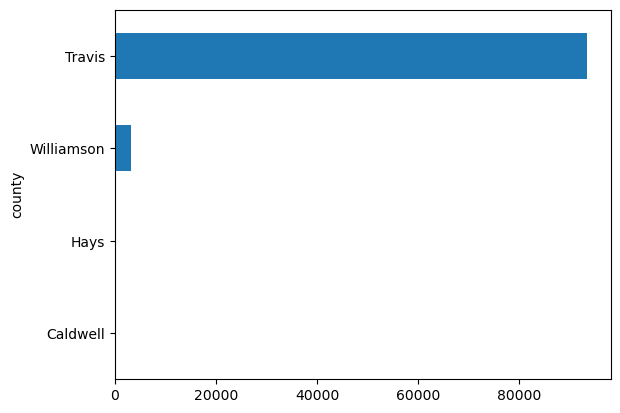

In [12]:
# Count accidents by county 
accidents_by_county = (
    austin_df['county']
    .value_counts()
    .sort_values(ascending = True)
)
# build bar chart
accidents_by_county.plot(kind = 'barh')

In [13]:
austin_df['county'].unique()

array(['Travis', 'Williamson', 'Hays', 'Caldwell'], dtype=object)

<Axes: ylabel='zipcode'>

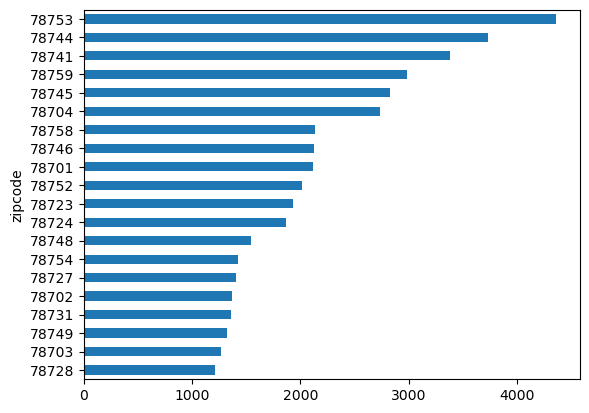

In [14]:
# Count accidents by zipcode 
accidents_by_zipcode = (
    austin_df['zipcode']
    .value_counts()
    .sort_values(ascending = True)
    .tail(20)
)

# build bar chart
accidents_by_zipcode.plot(kind = 'barh')

## Time trends

In [15]:
# Accidents by time(yy-mm)
# Convert 'start_time' column to datetime with error handling
austin_df['start_time'] = pd.to_datetime(austin_df['start_time'], errors='coerce', format='mixed')

# Create 'start_year_month' column for year and month
austin_df['start_year_month'] = austin_df['start_time'].dt.to_period('M')

# Group by 'start_year_month' and 'County' and count the number of accidents
accidents_by_year_month_county = (
    austin_df
    .groupby(['start_year_month', 'county'])
    .size()
    .reset_index(name='accident_count')
)

# Convert 'start_year_month' to datetime for Plotly compatibility
accidents_by_year_month_county['start_year_month'] = accidents_by_year_month_county['start_year_month'].dt.to_timestamp()

# Review
# accidents_by_year_month_county

# Plot the area chart using Plotly, with 'County' as color
fig = px.area(
    accidents_by_year_month_county,
    x='start_year_month',
    y='accident_count',
    color='county',
    title='Accidents by Year, Month, and County in Austin, TX',
    labels={'start_year_month': 'Year-Month', 'accident_count': 'Number of Accidents'}
)

# Show the plot
fig.show()


In [16]:
# Ensure 'start_year_month' is in datetime format
accidents_by_year_month_county['start_year_month'] = pd.to_datetime(accidents_by_year_month_county['start_year_month'])

# Create a static line chart
fig = px.line(
    accidents_by_year_month_county,
    x='start_year_month',
    y='accident_count',
    color='county',
    title='Austin Accidents Trends Over Time by County',
    labels={'start_year_month': 'Year-Month', 'accident_count': 'Number of Accidents'}
)

# Update layout for better visualization
fig.update_layout(
    xaxis_title='Year-Month',
    yaxis_title='Number of Accidents',
    xaxis=dict(tickformat='%Y-%m')
)

# Show the plot
fig.show()

In [17]:
austin_df

,id,severity,start_time,end_time,start_lat,start_lng,distance(mi),street,city,county,...,no_exit,railway,roundabout,station,stop,traffic_calming,traffic_signal,turning_loop,sunrise_sunset,start_year_month
0,A-261009,2,2016-11-30 16:03:54,2016-11-30 17:20:00,30.336502,-97.755646,0.010,Mopac Expy S,Austin,Travis,...,False,False,False,False,False,False,False,False,Day,2016-11
1,A-261010,2,2016-11-30 16:32:18,2016-11-30 17:47:02,30.328165,-97.694305,0.000,E Saint Johns Ave,Austin,Travis,...,False,False,False,False,False,False,False,False,Day,2016-11
2,A-261011,2,2016-11-30 16:31:45,2016-11-30 17:46:34,30.326077,-97.692307,0.000,Cameron Rd,Austin,Travis,...,False,False,False,True,False,False,True,False,Day,2016-11
3,A-261028,2,2016-11-30 17:11:22,2016-11-30 17:41:09,30.332523,-97.686707,0.010,US-183 S,Austin,Travis,...,False,False,False,False,False,False,False,False,Day,2016-11
4,A-261039,2,2016-11-30 17:16:42,2016-11-30 17:46:32,30.292852,-97.747017,0.010,N Lamar Blvd,Austin,Travis,...,False,False,False,False,False,False,False,False,Day,2016-11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96599,A-7775008,4,2019-08-18 04:03:40,2019-08-18 04:33:09,30.341300,-97.769622,0.756,Ranch Road 2222,Austin,Travis,...,False,False,False,False,False,False,True,False,Night,2019-08
96600,A-7775009,4,2019-08-18 04:03:40,2019-08-18 04:33:09,30.341688,-97.782288,0.756,Butte Blvd,Austin,Travis,...,False,False,False,False,False,False,False,False,Night,2019-08
96601,A-7775010,4,2019-08-18 05:18:40,2019-08-18 05:47:20,30.341688,-97.782288,0.756,Butte Blvd,Austin,Travis,...,False,False,False,False,False,False,False,False,Night,2019-08
96602,A-7777478,2,2019-08-23 08:34:56,2019-08-23 09:04:52,30.437960,-97.777150,0.778,US-183 S,Austin,Williamson,...,False,False,False,False,False,False,False,False,Day,2019-08


In [18]:
# Extract hour from 'start_time'
austin_df['hour'] = austin_df['start_time'].dt.hour

# Calculate the distribution of hours for all days
x_all = austin_df['hour']

# Create histogram trace for all days combined
trace_all = go.Histogram(
    x=x_all,
    name='All Days',
    autobinx=False,
    marker=dict(
        color='rgba(255, 100, 102, 0.7)',  # Transparent red
        line=dict(
            color='rgba(150, 200, 250, 1)',  # Solid blue border
            width=1
        )
    ),
    opacity=0.5,
    xbins=dict(
        start=0,
        end=24,
        size=1
    )
)

# Combine traces (only one in this case)
data = [trace_all]

# Define layout with 'overlay' mode for bar charts (not needed for single trace but kept for consistency)
layout = go.Layout(
    bargap=0.05,
    bargroupgap=0.2,
    barmode='overlay',  # 'overlay' mode is redundant here but left for consistency
    title='Distribution of Accidents by Hour for All Days',
    xaxis=dict(title='Hour of Day', range=[0, 24]),
    yaxis=dict(title='Count')
)

# Create figure
fig = go.Figure(data=data, layout=layout)

# Show the plot
fig.show()

In [19]:

# Categorize each entry as 'Weekday' or 'Weekend'
austin_df['day_type'] = austin_df['start_time'].dt.dayofweek.apply(lambda x: 'Weekend' if x >= 5 else 'Weekday')

# Separate data into Weekday and Weekend
weekday_data = austin_df[austin_df['day_type'] == 'Weekday']
weekend_data = austin_df[austin_df['day_type'] == 'Weekend']

# Calculate the average number of accidents per hour for Weekdays and Weekends
weekday_avg = austin_df[austin_df['day_type'] == 'Weekday'].groupby('hour').size() / 5  # Average over 5 days
weekend_avg = austin_df[austin_df['day_type'] == 'Weekend'].groupby('hour').size() / 2  # Average over 2 days

# Create histogram traces for Weekdays and Weekends
trace_weekday = go.Bar(
    x=weekday_avg.index,
    y=weekday_avg,
    name='Weekday',
    marker=dict(
        color='rgba(255, 100, 102, 0.7)',  # Transparent red
        line=dict(
            color='rgba(255, 100, 102, 1)',  # Solid red border
            width=1
        )
    ),
    opacity=0.5
)

trace_weekend = go.Bar(
    x=weekend_avg.index,
    y=weekend_avg,
    name='Weekend',
    marker=dict(
        color='rgba(100, 200, 102, 0.7)',  # Transparent green
        line=dict(
            color='rgba(100, 200, 102, 1)',  # Solid green border
            width=1
        )
    ),
    opacity=0.5
)

# Combine traces
data = [trace_weekday, trace_weekend]

# Define layout with 'overlay' mode for bar charts
layout = go.Layout(
    bargap=0.05,
    bargroupgap=0.2,
    barmode='overlay',  # Overlay bars to show both groups transparently
    title='Average Number of Accidents by Hour and Day Type',
    xaxis=dict(title='Hour of Day', range=[0, 24]),
    yaxis=dict(title='Average Number of Accidents per Hour')
)

# Create figure
fig = go.Figure(data=data, layout=layout)

# Show the plot
fig.show()

In [20]:
# Calculate the distribution of hours for Weekdays and Weekends
x_weekday = weekday_data['hour']
x_weekend = weekend_data['hour']

# Create normalized histogram traces for Weekdays and Weekends
trace_weekday = go.Histogram(
    x=x_weekday,
    name='Weekday',
    histnorm='probability',  # Normalize by total number of accidents
    autobinx=False,
    marker=dict(
        color='rgba(255, 100, 102, 0.7)',  # Transparent red
        line=dict(
            color='rgba(255, 100, 102, 1)',  # Solid red border
            width=1
        )
    ),
    opacity=0.5,
    xbins=dict(
        start=0,
        end=24,
        size=1
    )
)

trace_weekend = go.Histogram(
    x=x_weekend,
    name='Weekend',
    histnorm='probability',  # Normalize by total number of accidents
    autobinx=False,
    marker=dict(
        color='rgba(100, 200, 102, 0.7)',  # Transparent green
        line=dict(
            color='rgba(100, 200, 102, 1)',  # Solid green border
            width=1
        )
    ),
    opacity=0.5,  # Adjust the opacity for better overlay
    xbins=dict(
        start=0,
        end=24,
        size=1
    )
)

# Combine traces
data = [trace_weekday, trace_weekend]

# Define layout with 'overlay' mode for bar charts
layout = go.Layout(
    bargap=0.05,
    bargroupgap=0.2,
    barmode='overlay',  # Overlay bars to show both groups transparently
    title='Normalized Distribution of Accidents by Hour and Day Type',
    xaxis=dict(title='Hour of Day', range=[0, 24]),
    yaxis=dict(title='Proportion of Accidents')
)

# Create figure
fig = go.Figure(data=data, layout=layout)

# Show the plot
fig.show()

### Analysis：

After normalizing the histogram, the y-axis represents the proportion (or percentage) of accidents per hour relative to the total number of accidents in that group (weekday or weekend). For example, if the bar value for 8 AM on a weekday is 0.05 (or 5%), it means that out of all accidents occurring on weekdays, 5% happened at 8 AM. 

Normalization takes into account differences between different numbers of days (5 weekdays versus 2 weekends), allowing for comparison of accident distribution between weekdays and weekends on a daily basis without being affected by differences in day counts.

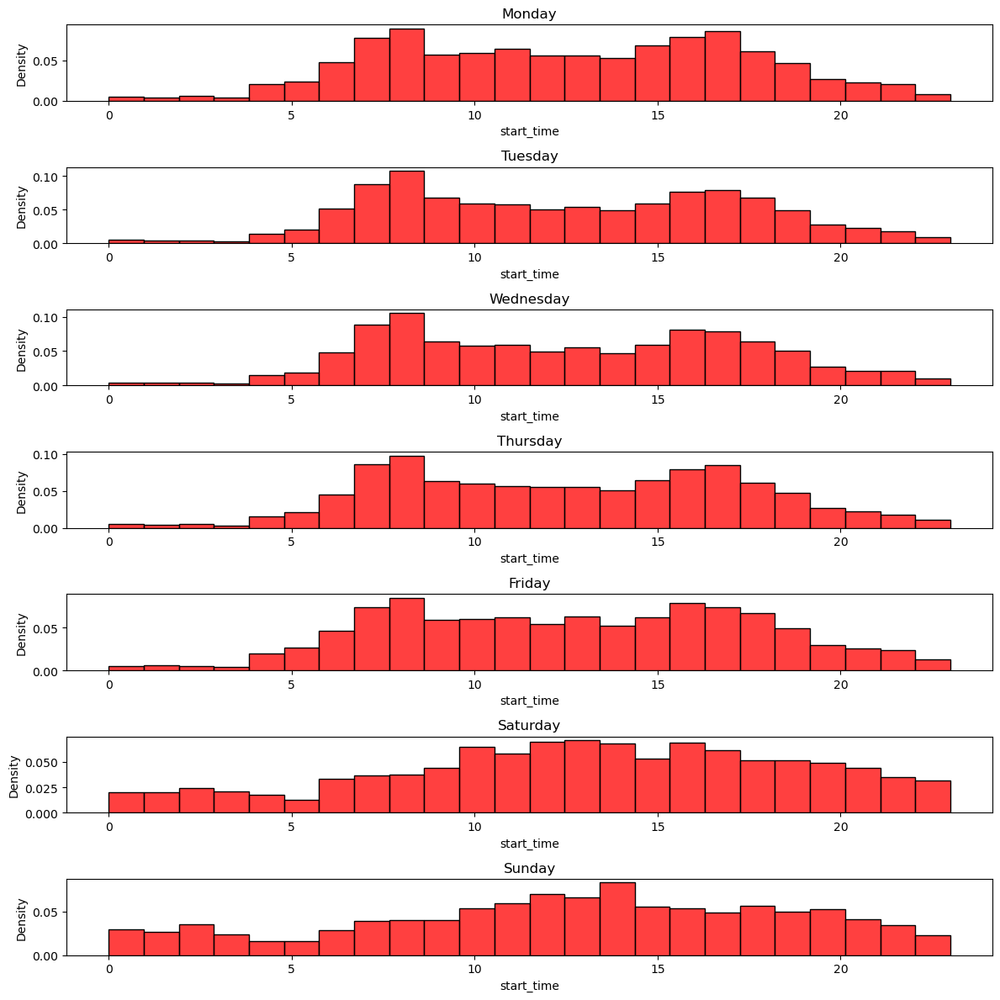

In [21]:

# Extract days of the week
mon_day = austin_df['start_time'][austin_df['start_time'].dt.dayofweek == 0]
tues_day = austin_df['start_time'][austin_df['start_time'].dt.dayofweek == 1]
wednes_day = austin_df['start_time'][austin_df['start_time'].dt.dayofweek == 2]
thurs_day = austin_df['start_time'][austin_df['start_time'].dt.dayofweek == 3]
fri_day = austin_df['start_time'][austin_df['start_time'].dt.dayofweek == 4]
satur_day = austin_df['start_time'][austin_df['start_time'].dt.dayofweek == 5]
sun_day = austin_df['start_time'][austin_df['start_time'].dt.dayofweek == 6]

# Create subplots
fig, axis = plt.subplots(7, 1, figsize=(12, 12))

# Plot each day
sns.histplot(mon_day.dt.hour, bins=24, kde=False, stat='density', ax=axis[0], color='red').set_title('Monday')
sns.histplot(tues_day.dt.hour, bins=24, kde=False, stat='density', ax=axis[1], color='red').set_title('Tuesday')
sns.histplot(wednes_day.dt.hour, bins=24, kde=False, stat='density', ax=axis[2], color='red').set_title('Wednesday')
sns.histplot(thurs_day.dt.hour, bins=24, kde=False, stat='density', ax=axis[3], color='red').set_title('Thursday')
sns.histplot(fri_day.dt.hour, bins=24, kde=False, stat='density', ax=axis[4], color='red').set_title('Friday')
sns.histplot(satur_day.dt.hour, bins=24, kde=False, stat='density', ax=axis[5], color='red').set_title('Saturday')
sns.histplot(sun_day.dt.hour, bins=24, kde=False, stat='density', ax=axis[6], color='red').set_title('Sunday')

fig.tight_layout()
plt.show()

In [22]:
# Extract month from 'start_time'
austin_df['month'] = austin_df['start_time'].dt.month

# Calculate the distribution of months
x_month = austin_df['month']

# Create histogram trace for months
trace_month = go.Histogram(
    x=x_month,
    name='Accidents by Month',
    autobinx=False,
    marker=dict(
        color='rgba(255, 50, 50, 0.8)',  # Vibrant red
        line=dict(
            color='rgba(255, 50, 50, 1)',  # Solid red border
            width=1
        )
    ),
    opacity=0.5,
    xbins=dict(
        start=1,
        end=12,
        size=1
    )
)

# Combine traces (only one in this case)
data = [trace_month]

# Define layout with 'overlay' mode for bar charts (not needed for single trace but kept for consistency)
layout = go.Layout(
    bargap=0.05,
    bargroupgap=0.2,
    barmode='overlay',  # 'overlay' mode is redundant here but left for consistency
    title='Distribution of Accidents by Month',
    xaxis=dict(
        title='Month',
        tickmode='array',
        tickvals=[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12],
        ticktext=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
    ),
    yaxis=dict(title='Count')
)

# Create figure
fig = go.Figure(data=data, layout=layout)

# Show the plot
fig.show()

In [23]:
# yearly

# Extract month and year from 'start_time'
austin_df['year'] = austin_df['start_time'].dt.year

# Create a list to hold all traces
data = []

# Add an "All" category to show all years combined with a specific color
trace_all = go.Histogram(
    x=austin_df['month'],
    name='All',  # Use "All" as the name
    autobinx=False,
    marker=dict(
        color='rgba(255, 100, 100, 0.7)',  # Specific red color
        line=dict(
            color='rgba(255, 100, 100, 1)',  # Solid red border
            width=1
        )
    ),
    opacity=0.7,
    xbins=dict(
        start=1,
        end=12,
        size=1
    ),
    visible='legendonly'  # Start with 'All' trace hidden
)

# Add the "All" trace to the data list
data.append(trace_all)

# Sort years in ascending order
sorted_years = sorted(austin_df['year'].unique())

# Loop through each sorted year and create a histogram trace
for year in sorted_years:
    # Filter data for the current year
    yearly_data = austin_df[austin_df['year'] == year]
    
    # Extract month data for the current year
    x_month = yearly_data['month']
    
    # Create histogram trace for the current year
    trace = go.Histogram(
        x=x_month,
        name=str(year),  # Use year as the name
        autobinx=False,
        marker=dict(
            line=dict(
                width=1
            )
        ),
        opacity=0.5,
        xbins=dict(
            start=1,
            end=12,
            size=1
        ),
        visible=True  # Start with individual years visible
    )
    
    # Add trace to the data list
    data.append(trace)

# Define layout with custom legend behavior
layout = go.Layout(
    bargap=0.05,
    bargroupgap=0.2,
    barmode='overlay',  # Use 'overlay' for transparent bars
    title='Monthly Distribution of Accidents for Each Year',
    xaxis=dict(
        title='Month',
        tickmode='array',
        tickvals=[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12],
        ticktext=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
    ),
    yaxis=dict(title='Count'),
    legend=dict(
        title='Year Selection',
        itemsizing='constant'
    )
)

# Create figure
fig = go.Figure(data=data, layout=layout)

# Add buttons to update trace visibility
fig.update_layout(
    updatemenus=[
        dict(
            type="buttons",
            direction="right",
            buttons=list([
                dict(
                    args=[{"visible": [True] + [False] * len(sorted_years)}],
                    label="Show All",
                    method="update"
                ),
                dict(
                    args=[{"visible": [False] + [True] * len(sorted_years)}],
                    label="Select Years",
                    method="update"
                )
            ]),
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.5,  # Center the buttons horizontally above the legend
            xanchor="center",
            y=1.2,  # Position the buttons above the plot area
            yanchor="top"
        ),
    ]
)

# Show the plot
fig.show()

## Impact of Traffic Accidents

In [24]:
## Data Preparation

# Ensure 'Start_Time' and 'End_Time' are in datetime format
austin_df['start_time'] = pd.to_datetime(austin_df['start_time'], errors='coerce', format='mixed')
austin_df['end_time'] = pd.to_datetime(austin_df['end_time'], errors='coerce', format='mixed')

# Calculate duration in minutes
austin_df['duration'] = round((austin_df['end_time'] - austin_df['start_time']).dt.total_seconds() / 60, 0)

# Select relevant columns for analysis
geo_data = austin_df[['id', 'start_lat', 'start_lng', 'severity', 'duration', 'distance(mi)']]

# Rename 'Distance(mi)' to 'Distance' for simplicity
geo_data.rename(columns={'distance(mi)': 'distance'}, inplace=True)

# Display the prepared data
geo_data.head()

,id,start_lat,start_lng,severity,duration,distance
0,A-261009,30.336502,-97.755646,2,76.0,0.01
1,A-261010,30.328165,-97.694305,2,75.0,0.00
2,A-261011,30.326077,-97.692307,2,75.0,0.00
3,A-261028,30.332523,-97.686707,2,30.0,0.01
4,A-261039,30.292852,-97.747017,2,30.0,0.01


In [25]:
geo_data.describe()

,start_lat,start_lng,severity,duration,distance
count,96604.000000,96604.000000,96604.000000,96604.000000,96604.000000
mean,30.297193,-97.740694,2.088785,98.386174,0.133442
std,0.084292,0.064397,0.322085,922.846767,0.508958
min,30.070537,-98.064842,1.000000,8.000000,0.000000
25%,30.233083,-97.771538,2.000000,30.000000,0.000000
50%,30.286921,-97.735562,2.000000,47.000000,0.000000
75%,30.363173,-97.697701,2.000000,92.000000,0.048000
max,30.513420,-97.554594,4.000000,283078.000000,52.876000


In [26]:
# Convert 'severity' to a categorical variable (if not already done)
geo_data['severity'] = geo_data['severity'].astype(str)

# Convert 'duration' to categorical variable without units
# Bins: 0 to 30, 30 to 60, 60 to 120, Over 120
duration_bins = [0, 30, 60, 120, geo_data['duration'].max()]
duration_labels = ['0 to 30', '30 to 60', '60 to 120', 'Over 120']
geo_data['duration_category'] = pd.cut(geo_data['duration'], bins=duration_bins, labels=duration_labels, include_lowest=True)

# Convert 'distance' to categorical variable without units
# Bins: 0 to 0.1, 0.1 to 0.5, 0.5 to 1, Over 1
distance_bins = [0, 0.1, 0.5, 1, geo_data['distance'].max()]
distance_labels = ['0 to 0.1', '0.1 to 0.5', '0.5 to 1', 'Over 1']
geo_data['distance_category'] = pd.cut(geo_data['distance'], bins=distance_bins, labels=distance_labels, include_lowest=True)

geo_data

,id,start_lat,start_lng,severity,duration,distance,duration_category,distance_category
0,A-261009,30.336502,-97.755646,2,76.0,0.010,60 to 120,0 to 0.1
1,A-261010,30.328165,-97.694305,2,75.0,0.000,60 to 120,0 to 0.1
2,A-261011,30.326077,-97.692307,2,75.0,0.000,60 to 120,0 to 0.1
3,A-261028,30.332523,-97.686707,2,30.0,0.010,0 to 30,0 to 0.1
4,A-261039,30.292852,-97.747017,2,30.0,0.010,0 to 30,0 to 0.1
...,...,...,...,...,...,...,...,...
96599,A-7775008,30.341300,-97.769622,4,29.0,0.756,0 to 30,0.5 to 1
96600,A-7775009,30.341688,-97.782288,4,29.0,0.756,0 to 30,0.5 to 1
96601,A-7775010,30.341688,-97.782288,4,29.0,0.756,0 to 30,0.5 to 1
96602,A-7777478,30.437960,-97.777150,2,30.0,0.778,0 to 30,0.5 to 1


In [27]:
# # Define a custom color scale with four discrete colors: light blue, light green, light yellow, peach pink
# color_scale = ['#ADD8E6', '#90EE90', '#FFFFE0', '#FFB6C1']  # Light blue, light green, light yellow, peach pink

# Define a custom color scale with specific colors
# 1 -> Light Grey, 2 -> Light Blue, 3 -> Yellow, 4 -> Red
color_scale = ['#D3D3D3', '#5DADE2', '#FFFF00', '#FF0000']  # Light grey, light blue, yellow, red

# Create the scatter map using OpenStreetMap as the base layer
fig = px.scatter_mapbox(
    geo_data, 
    lat='start_lat', 
    lon='start_lng', 
    hover_name='severity',  # Display severity when hovering over points
    hover_data={'duration': True, 'distance': True},  # Additional info on hover
    color='severity',  # Treat severity as a categorical variable
    category_orders={"severity": ['1', '2', '3', '4']},  # Specify the order of severity levels
    color_discrete_sequence=color_scale,  # Use discrete colors for severity levels
    size_max=15,
    zoom=10,  # Adjust zoom level to fit your data
    title="Accident Distribution Map by Severity"
)

# Reverse legend order to have severity levels from bottom (1) to top (4)
fig.update_layout(
    mapbox_style='open-street-map',
    legend_title_text='Severity Levels',
    legend=dict(
        traceorder='normal'  # Keep the normal order for legend items
    ),
    margin={"r":0,"t":0,"l":0,"b":0}  # Adjust margins for better display
)

# Show the plot
fig.show()

In [31]:

import pandas as pd
import plotly.express as px

# Ensure that 'severity', 'duration_category', and 'distance_category' are treated as categorical variables
geo_data['severity'] = pd.Categorical(geo_data['severity'], categories=['1', '2', '3', '4'], ordered=True)
geo_data['duration_category'] = pd.Categorical(geo_data['duration_category'], categories=['0 to 30', '30 to 60', '60 to 120', 'Over 120'], ordered=True)
geo_data['distance_category'] = pd.Categorical(geo_data['distance_category'], categories=['0 to 0.1', '0.1 to 0.5', '0.5 to 1', 'Over 1'], ordered=True)

# Define the color scale for severity, duration, and distance categories
color_scale = ['#D3D3D3', '#5DADE2', '#FFFF00', '#FF0000']  # Grey, blue, yellow, red

# Create a scatter map with 'severity' as the initial color dimension
fig = px.scatter_mapbox(
    geo_data,
    lat='start_lat',
    lon='start_lng',
    hover_name='severity',  # Display severity when hovering over points
    hover_data={'duration': True, 'distance': True},  # Additional info on hover
    color='severity',  # Initial color by severity
    category_orders={"severity": ['1', '2', '3', '4']},  # Specify the order of severity levels
    color_discrete_sequence=color_scale,  # Use discrete colors for severity levels
    size_max=15,
    zoom=10,
    title="Accident Distribution Map"
)

# Add dropdown buttons to update the color dimension
fig.update_layout(
    mapbox_style='open-street-map',
    legend_title_text='Color By',
    margin={"r":0,"t":50,"l":0,"b":0},  # Adjust margins for better display
    updatemenus=[
        {
            'buttons': [
                {
                    'method': 'update',
                    'label': 'Severity',
                    'args': [{'marker.color': geo_data['severity']},
                             {'marker': {'colorscale': color_scale},
                              'coloraxis': {'colorbar': {'title': 'Severity Levels'}}}]
                },
                {
                    'method': 'update',
                    'label': 'Duration Category',
                    'args': [{'marker.color': geo_data['duration_category']},
                             {'marker': {'colorscale': color_scale},
                              'coloraxis': {'colorbar': {'title': 'Duration Category'}}}]
                },
                {
                    'method': 'update',
                    'label': 'Distance Category',
                    'args': [{'marker.color': geo_data['distance_category']},
                             {'marker': {'colorscale': color_scale},
                              'coloraxis': {'colorbar': {'title': 'Distance Category'}}}]
                },
            ],
            'direction': 'down',
            'showactive': True,
            'x': 0.3,  # Move the dropdown to the right of the map
            'xanchor': 'left',
            'y': 1.15,  # Align it with the top of the map
            'yanchor': 'top'
        }
    ]
)

# Update the legend items to be square-shaped for better visibility and clarity
fig.update_traces(marker=dict(size=8))  # Adjust marker size if needed

# Show the plot
fig.show()
